In [1]:
# -*- coding: utf-8 -*-
import scanpy as sc
import pandas as pd
from sklearn import metrics
import torch

import matplotlib.pyplot as plt
import seaborn as sns

import os
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import StPedf

In [ ]:

random_seed = 2025
StPedf.fix_seed(random_seed)

In [ ]:

adata = sc.read("F:/StPedf/data/axolotl brain regeneration afrer injury/D15_4.ST.exp.tsv")
df_annot = pd.read_table("F:/StPedf/data/axolotl brain regeneration afrer injury/D15_4.ST.annot.tsv")


adata.obsm["spatial"] = df_annot[["x", "y"]].values  
adata.obs["cluster"] = df_annot["cluster"].values


Only considering the two last: ['.exp', '.tsv'].
Only considering the two last: ['.exp', '.tsv'].


In [ ]:

sc.pp.filter_genes(adata, min_cells=10)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['count'] = adata.X.copy()


sc.pp.highly_variable_genes(adata, flavor="seurat_v3", layer='count', n_top_genes=2000)
adata = adata[:, adata.var['highly_variable']]


#sc.pp.scale(adata)
sc.pp.pca(adata, n_comps=100)


In [6]:
print(adata.obsm.keys())

KeysView(AxisArrays with keys: spatial, X_pca)


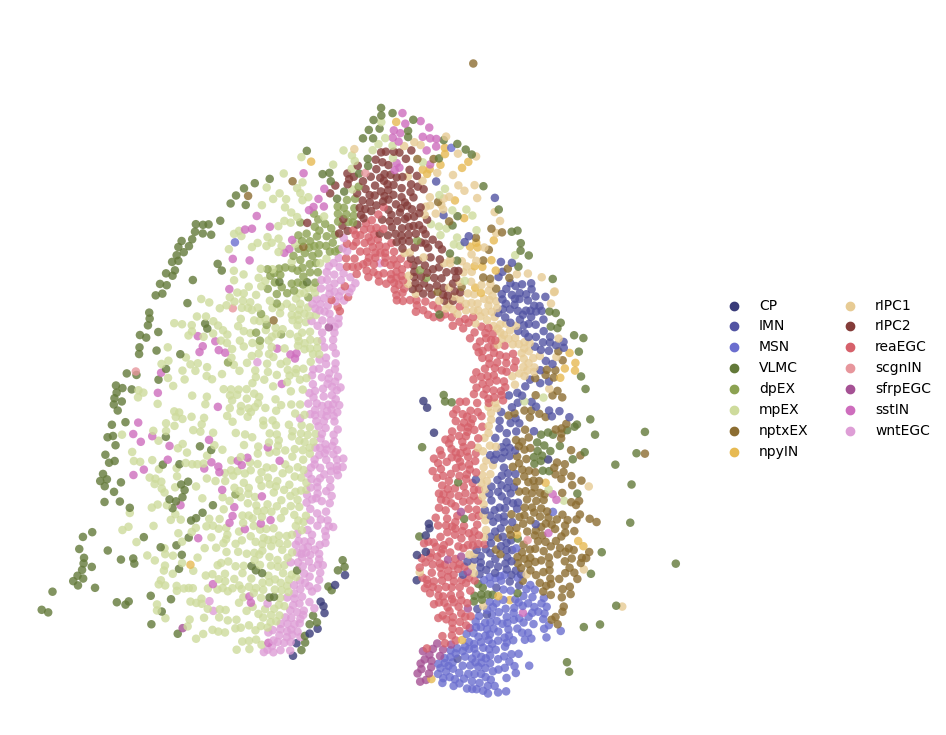

In [7]:
adata.obsm['X_spatial'] = adata.obsm['spatial']
fig, axs = plt.subplots(figsize=(9, 9))
ax = sc.pl.embedding(adata,  basis='spatial',show=False,title=' ',color='cluster',ax=axs,frameon=False,palette='tab20b',legend_fontweight='normal',alpha=0.8,size=150)

In [ ]:
graph_dict = StPedf.graph_construction(
    adata, 
    12,
    mode='AlphaComplex', 
    alpha_n_neighbors=15  
)
print(graph_dict.keys())


空间图构建完成: dict_keys(['adj_norm', 'adj_label', 'norm_value'])


In [ ]:
# gpu
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'




sedr_net = StPedf.Sedr(
    adata.obsm['X_pca'], 
    graph_dict, 
    mode='clustering',
    device=device
)

In [ ]:
sedr_net = StPedf.Sedr(adata.obsm['X_pca'], graph_dict, mode='clustering', device=device)
using_dec = True
n_epochs = 200

if using_dec:
    # 使用基础参数训练
    sedr_net.train_with_dec(N=n_epochs)  # 移除不支持的参数
    sedr_feat, _, _, _, _ = sedr_net.process()
    adata.obsm['SEDR'] = sedr_feat

100%|██████████| 200/200 [00:02<00:00, 72.37it/s]


In [11]:
import numpy as np

In [13]:
import collections
collections.Iterable = collections.abc.Iterable  # 临时修复兼容问题
import spaTrack as spt
from anndata import AnnData
from sklearn.metrics import pairwise_distances

In [ ]:
# %% [markdown]

import torch
# %% 
# 导入库
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import ot
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import StandardScaler
from tqdm import tqdm


import TI as spt
from anndata import AnnData

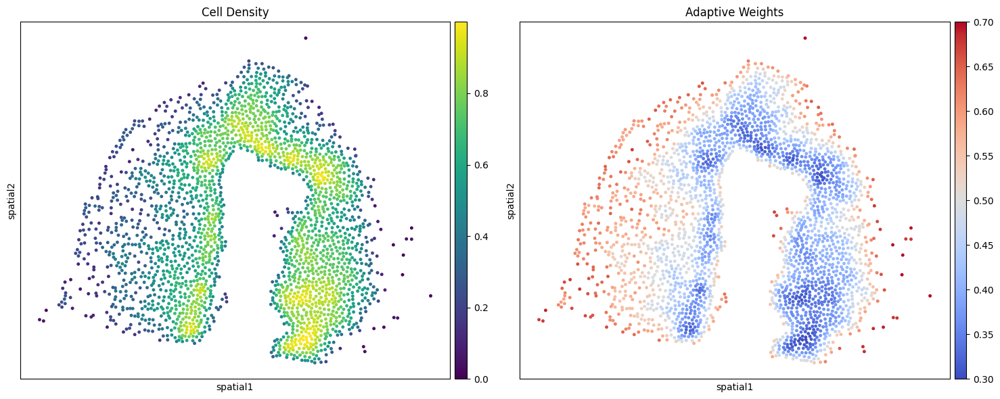

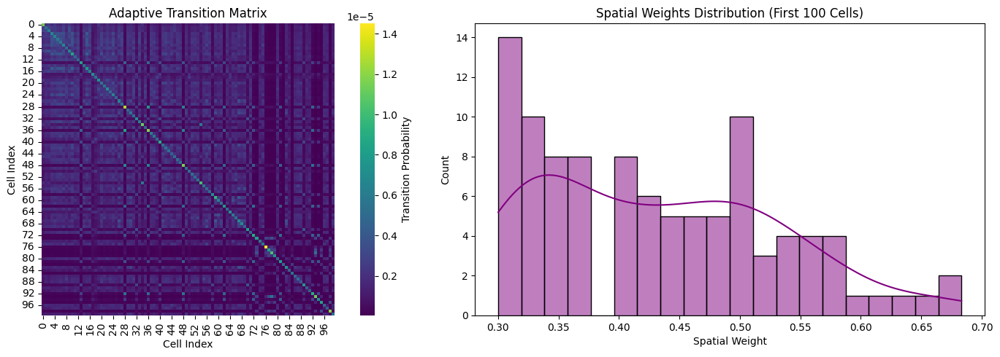

In [ ]:
def construct_adaptive_transition_matrix(
    adata: AnnData,
    sedr_key: str = 'SEDR',
    spatial_key: str = 'spatial',
    reg: float = 0.1,
    base_alpha: float = 0.5,  
    alpha_range: tuple = (0.3, 0.7), 
    spot_size: float = 100  
):

    sedr_emb = adata.obsm[sedr_key]
    spatial_coords = adata.obsm[spatial_key]
    

    sedr_dist = pairwise_distances(sedr_emb)
    spatial_dist = pairwise_distances(spatial_coords)
    

    sedr_dist /= sedr_dist.max()
    spatial_dist /= spatial_dist.max()
    
    from sklearn.neighbors import KernelDensity

    kde = KernelDensity(bandwidth=50, kernel='gaussian')
    kde.fit(spatial_coords)
    density_scores = np.exp(kde.score_samples(spatial_coords))
    

    density_norm = (density_scores - density_scores.min()) / (
        density_scores.max() - density_scores.min() + 1e-10)
    
    min_alpha, max_alpha = alpha_range
    adaptive_alphas = min_alpha + (max_alpha - min_alpha) * (1 - density_norm)
    
    adata.obs['cell_density'] = density_norm
    adata.obs['spatial_weight'] = adaptive_alphas
    

    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    

    sc.pl.embedding(
        adata, 
        basis=spatial_key, 
        color='cell_density', 
        ax=axes[0], 
        show=False, 
        title='Cell Density',
        cmap='viridis',
        size=spot_size
    )
    

    sc.pl.embedding(
        adata, 
        basis=spatial_key, 
        color='spatial_weight', 
        ax=axes[1], 
        show=False, 
        title='Adaptive Weights',
        cmap='coolwarm',
        size=spot_size,
        vmin=min_alpha,
        vmax=max_alpha
    )
    
    plt.tight_layout()
    plt.show()
    

    M = np.zeros_like(spatial_dist)
    for i in range(len(adata)):
        alpha_i = adaptive_alphas[i]
        M[i] = alpha_i * spatial_dist[i] + (1 - alpha_i) * sedr_dist[i]
    
    a = b = np.ones(M.shape[0]) / M.shape[0]
    Gs = ot.sinkhorn(a, b, M, reg=reg)
    
    return Gs



trans = construct_adaptive_transition_matrix(
    adata,
    sedr_key='SEDR',
    spatial_key='spatial',
    reg=0.1, 
    base_alpha=0.5,
    alpha_range=(0.3, 0.7), 
    spot_size=50 
)


adata.obsp["adaptive_trans"] = trans

plt.figure(figsize=(15, 5))

plt.subplot(121)
sns.heatmap(trans[:100, :100], cmap='viridis', square=True, 
            cbar_kws={'label': 'Transition Probability'})
plt.title("Adaptive Transition Matrix")
plt.xlabel("Cell Index")
plt.ylabel("Cell Index")

plt.subplot(122)
sns.histplot(adata.obs['spatial_weight'].iloc[:100], bins=20, 
             kde=True, color='purple')
plt.title("Spatial Weights Distribution (First 100 Cells)")
plt.xlabel("Spatial Weight")
plt.ylabel("Count")

plt.tight_layout()
plt.show()

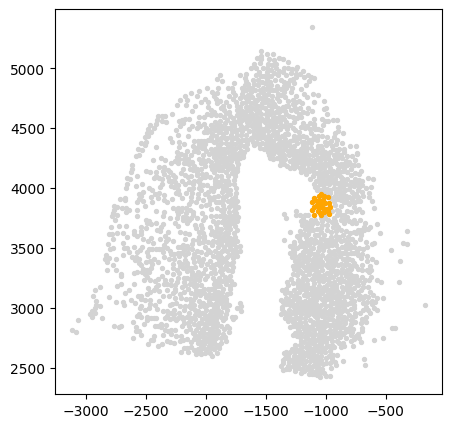

In [ ]:

adata.obsm['X_spatial'] = adata.obsm['spatial']
start_cells = spt.set_start_cells(adata, select_way='coordinates', cell_type='reaEGC', start_point=[-1050,3850], n_neigh=30)

fig, axs = plt.subplots(figsize=(5,5))
plt.scatter(adata.obsm['X_spatial'][:,0], adata.obsm['X_spatial'][:,1], c='#D3D3D3', s=8)
plt.scatter(adata.obsm['X_spatial'][start_cells][:,0], adata.obsm['X_spatial'][start_cells][:,1], c='orange', s=8)

In [ ]:

adata.obsp["trans"] = adata.obsp["adaptive_trans"]

print("Transfer matrix 'trans' added with shape:", adata.obsp["trans"].shape)

Transfer matrix 'trans' added with shape: (2396, 2396)


In [ ]:

start_cells = np.array(start_cells).flatten()
print(len(start_cells))  # 应大于1

起始细胞数量: 26


In [ ]:


print(adata.obs['cluster'].value_counts())


簇注释分布：
cluster
mpEX       558
reaEGC     333
VLMC       242
wntEGC     232
nptxEX     180
IMN        167
MSN        154
rIPC1      152
rIPC2      136
sstIN       83
dpEX        76
npyIN       36
sfrpEGC     24
CP          19
scgnIN       4
Name: count, dtype: int64


In [ ]:

adata.obsm['X_spatial'] = adata.obsm['spatial']

In [ ]:

adata.obs["ptime"] = spt.get_ptime(adata, start_cells=start_cells)



In [ ]:

def get_neigh_trans(adata, basis, n_neigh_total=30):

    if "SEDR" not in adata.obsm:
        raise ValueError("SEDR embedding not found")
    

    nn = NearestNeighbors(n_neighbors=n_neigh_total)
    nn.fit(adata.obsm["SEDR"])
    _, neigh_indices = nn.kneighbors()
    
    trans_matrix = adata.obsp["trans"] 
    
    indptr = [0]
    indices = []
    data = []
    for i in range(adata.n_obs):
        neighbors = neigh_indices[i]
        probs = trans_matrix[i, neighbors].A.flatten()
        probs /= probs.sum() 
        indices.extend(neighbors)
        data.extend(probs)
        indptr.append(len(indices))
    
    return csr_matrix((data, indices, indptr))

In [30]:
adata.uns["E_grid"], adata.uns["V_grid"] = spt.get_velocity(adata, basis="spatial", n_neigh_pos=50)

Cell velocities stored in 'velocity_spatial'


In [31]:
import matplotlib.ticker as ticker

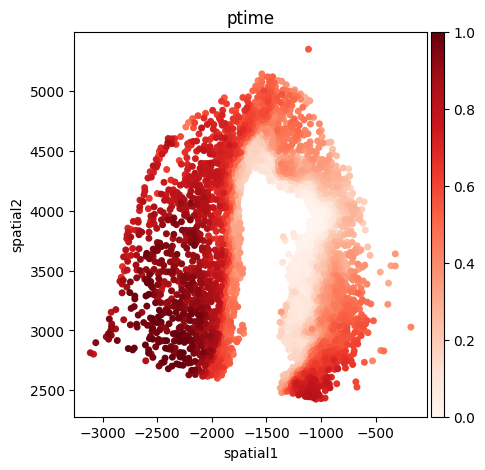

In [32]:
fig, axs = plt.subplots(figsize=(5, 5))
sc.pl.embedding(adata, basis='spatial', color='ptime', show=False, ax=axs, color_map='Reds', title='ptime', size=100)
axs.xaxis.set_major_locator(ticker.MultipleLocator(500))
axs.yaxis.set_major_locator(ticker.MultipleLocator(500))

In [ ]:
VecFld = spt.VectorField(
    adata,
    basis='spatial',
    velocity_key='velocity_spatial',  
    n_neighbors=80,
    smooth=1.2  
)

Locator attempting to generate 3216 ticks ([2279.0, ..., 5494.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3216 ticks ([2279.0, ..., 5494.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3216 ticks ([2279.0, ..., 5494.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3216 ticks ([2279.0, ..., 5494.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3216 ticks ([2279.0, ..., 5494.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3216 ticks ([2279.0, ..., 5494.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3232 ticks ([-3261.0, ..., -30.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3232 ticks ([-3261.0, ..., -30.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3232 ticks ([-3261.0, ..., -30.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 3232 ticks ([-3

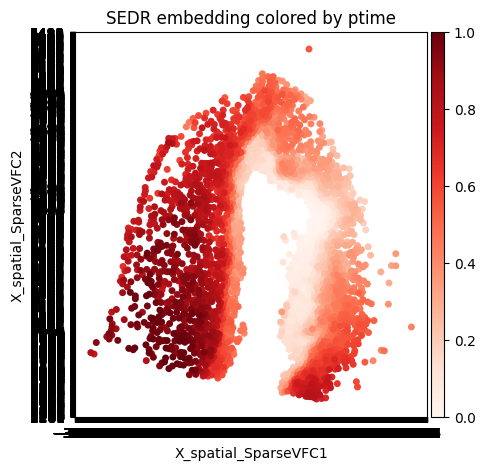

In [ ]:
import matplotlib.ticker as ticker  

fig, axs = plt.subplots(figsize=(5, 5))
sc.pl.embedding(
    adata,
    basis='X_spatial_SparseVFC',            
    color='ptime',           
    show=False,
    ax=axs,
    color_map='Reds',
    title='SEDR embedding colored by ptime',
    size=100
)

axs.xaxis.set_major_locator(ticker.MultipleLocator(1)) 
axs.yaxis.set_major_locator(ticker.MultipleLocator(1)) 

plt.show()

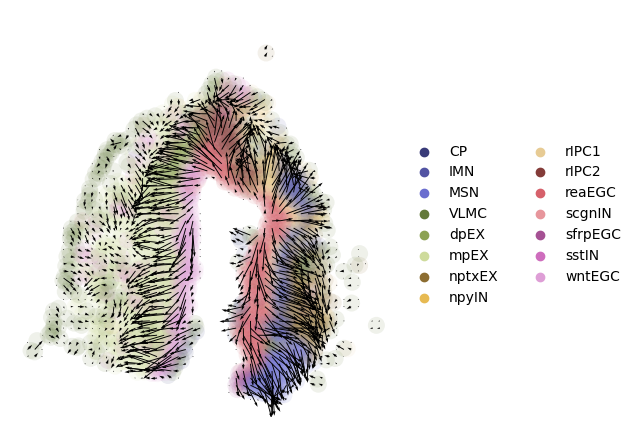

In [35]:
fig, axs = plt.subplots(figsize=(5, 5))
sc.pl.embedding(adata, basis='spatial',show=False,title=' ',color='cluster',ax=axs,frameon=False,palette='tab20b',legend_fontweight='normal',alpha=0.1,size=600)
axs.quiver(adata.uns['E_grid'][0],adata.uns['E_grid'][1],adata.uns['V_grid'][0],adata.uns['V_grid'][1],scale=0.008)

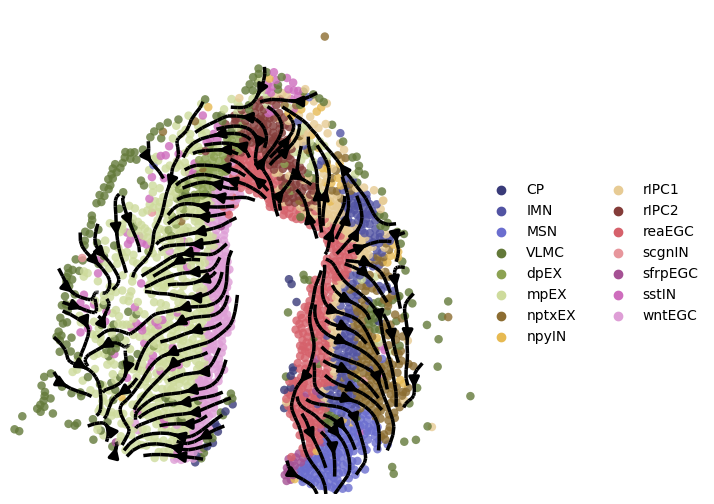

In [36]:
fig,axs=plt.subplots(ncols=1,nrows=1,figsize=(6,6))
ax = sc.pl.embedding(adata,  basis='spatial',show=False,title=' ',color='cluster',ax=axs,frameon=False,palette='tab20b',legend_fontweight='normal',alpha=0.8,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.8,color='black',linewidth=2.5,arrowsize=1.5)

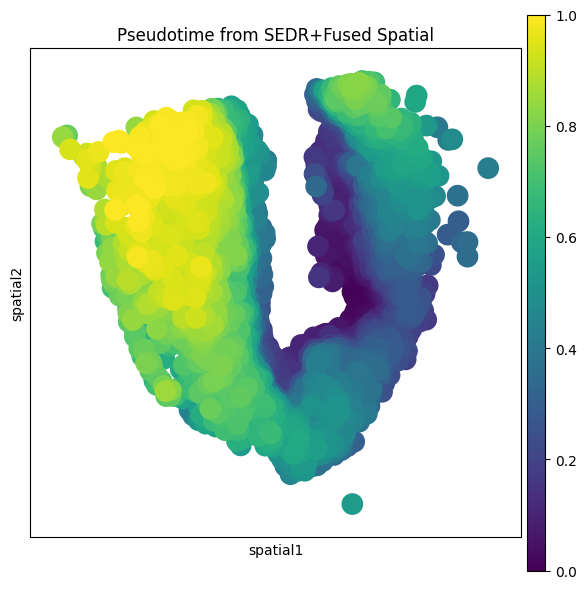

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.spatial(adata, color='ptime', title='Pseudotime from SEDR+Fused Spatial', 
              size=1.5, spot_size=100, ax=ax, show=False)  
plt.tight_layout()
plt.show()

In [38]:
VecFld=spt.VectorField(adata,basis='spatial')

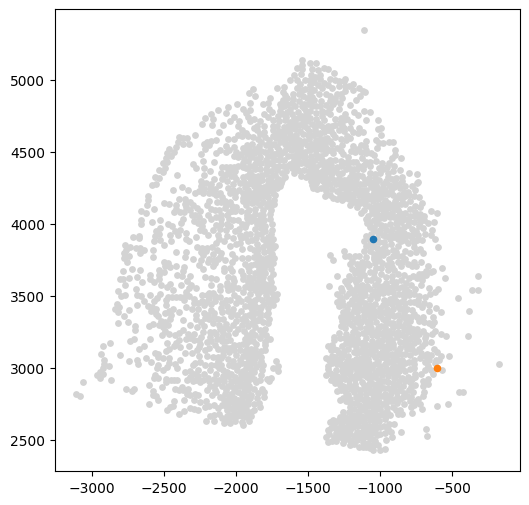

In [39]:
fig, ax = plt.subplots(figsize=(6, 6))

LAP_start_point=[-1050,3900]
LAP_end_point=[-625,3000]
LAP_start_cell=spt.nearest_neighbors(LAP_start_point,adata.obsm['spatial'])[0][0]
LAP_end_cell=spt.nearest_neighbors(LAP_end_point,adata.obsm['spatial'])[0][0]

plt.scatter(*adata.obsm["spatial"].T,c='#D3D3D3',s=15)
plt.scatter(*adata[LAP_start_cell].obsm['spatial'].T,s=20)
plt.scatter(*adata[LAP_end_cell].obsm['spatial'].T,s=20)

In [40]:
import scipy.sparse as sp
adata.obsp["fused_trans"] = sp.csr_matrix(trans)

In [ ]:
lap = spt.least_action(
    adata,
    init_cells=[adata.obs_names[LAP_start_cell]],  
    target_cells=[adata.obs_names[LAP_end_cell]],
    vecfld=VecFld,
    basis="spatial",
    adj_key="fused_trans",    
    EM_steps=5,
    n_points=20
)

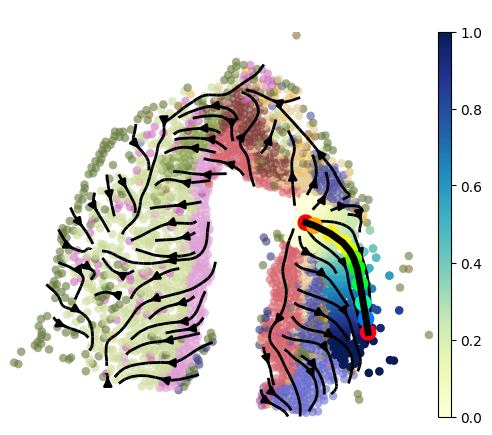

In [42]:
LAP_ptime,LAP_nbrs=spt.map_cell_to_LAP(adata,cell_neighbors=80)
sub_adata=adata[LAP_nbrs,:]
sub_adata.obs['ptime']=LAP_ptime
sub_adata=sub_adata[np.argsort(sub_adata.obs["ptime"].values), :].copy()

fig, ax = plt.subplots(figsize=(6,5))
plt.axis('off')
ax = sc.pl.embedding(adata,  basis='X_spatial',color='cluster',show=False,ax=ax,frameon=False,legend_loc=None,alpha=0.6,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.2,color='black',linewidth=2,arrowsize=1.2)
ax = spt.plot_least_action_path(adata,basis='spatial',ax=ax,point_size=120,linewidth=5)
sc.pl.embedding(sub_adata, basis='X_spatial',ax=ax, color="ptime", cmap="YlGnBu",frameon=True,size=150,title=' ')

In [43]:
sub_adata_path=sub_adata[sub_adata.obs['cluster'].isin(['reaEGC','rIPC1', 'IMN','nptxEX'])]
sub_adata_path=spt.filter_gene(sub_adata_path,min_exp_prop=0.1,hvg_gene=3000)

clusters ordered by ptime:  ['reaEGC', 'rIPC1', 'IMN', 'nptxEX']
Cell number	248
Gene number	363


In [44]:
df_res  = spt.ptime_gene_GAM(sub_adata_path,core_number=5)

Genes number fitted by GAM model:   363


In [45]:
df_sig_res = df_res.loc[(df_res['model_fit']>0.2) & (df_res['fdr']<0.05)]

Finally selected 94 genes.


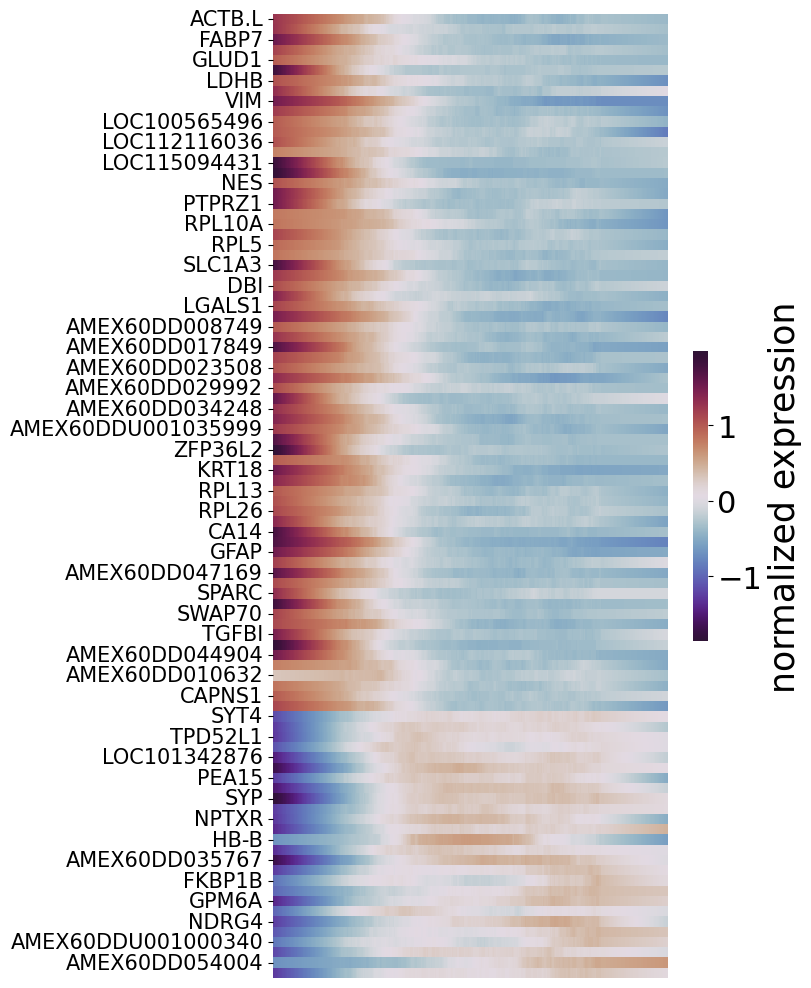

In [46]:
sort_exp_sig = spt.order_trajectory_genes(sub_adata,df_sig_res,cell_number=20)
spt.plot_trajectory_gene_heatmap(sort_exp_sig,smooth_length=100,gene_label_size=15,cmap_name='twilight_shifted')

In [ ]:

print(sub_adata[:, 'VIM'].X.min(), sub_adata[:, 'VIM'].X.max())

检查 VIM 基因表达值：
0.0 5.0501046


<Axes: title={'center': 'VIM'}, xlabel='ptime', ylabel='expression'>

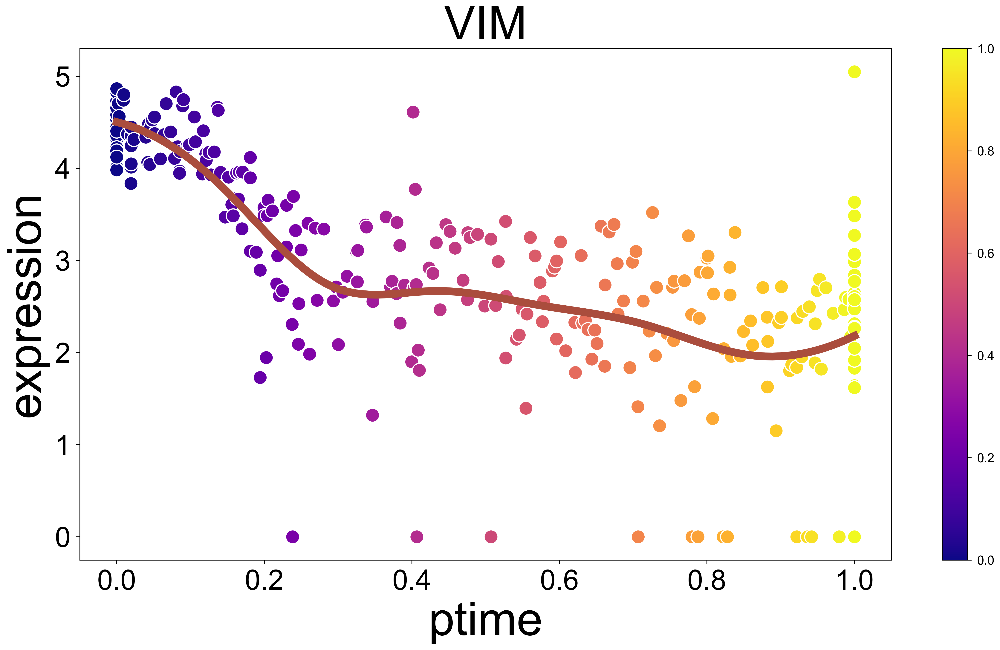

In [49]:
spt.plot_trajectory_gene(sub_adata,gene_name='VIM',point_size=80)

<Axes: title={'center': 'SYP'}, xlabel='ptime', ylabel='expression'>

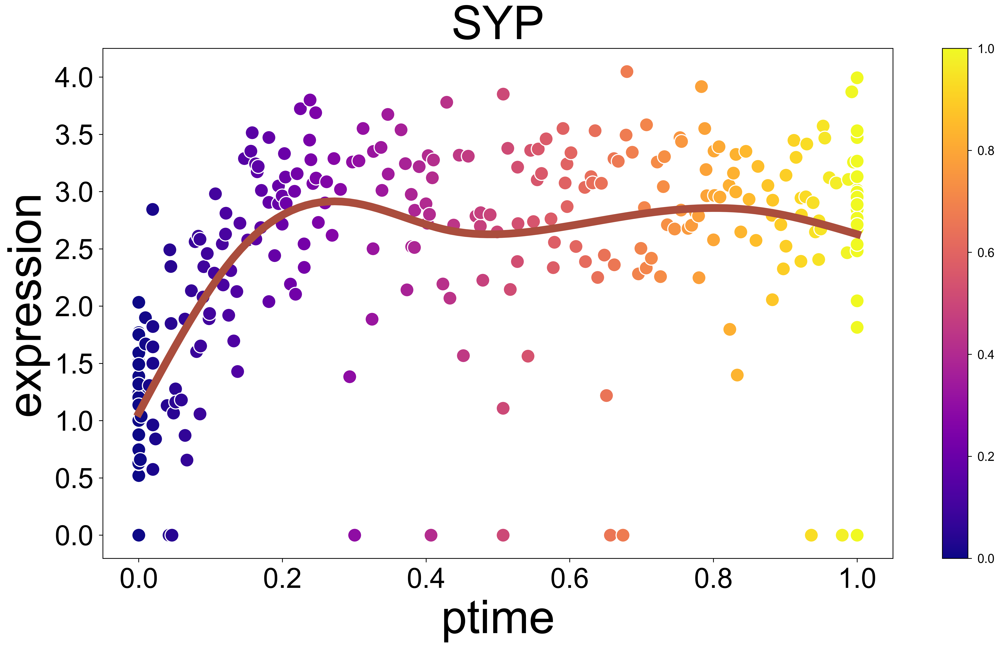

In [50]:
spt.plot_trajectory_gene(sub_adata,gene_name='SYP',point_size=80)

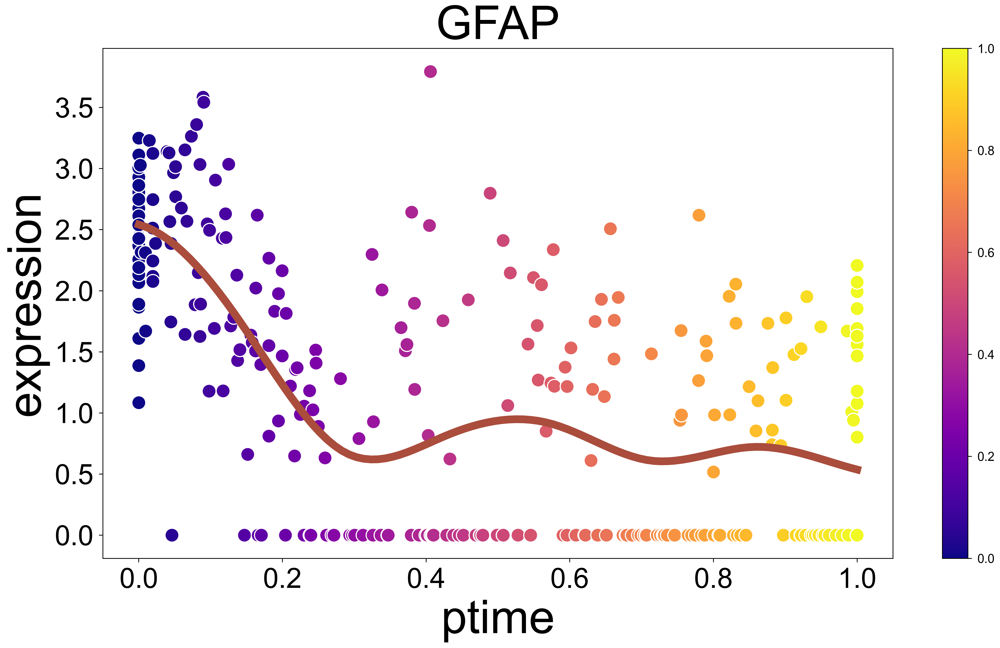

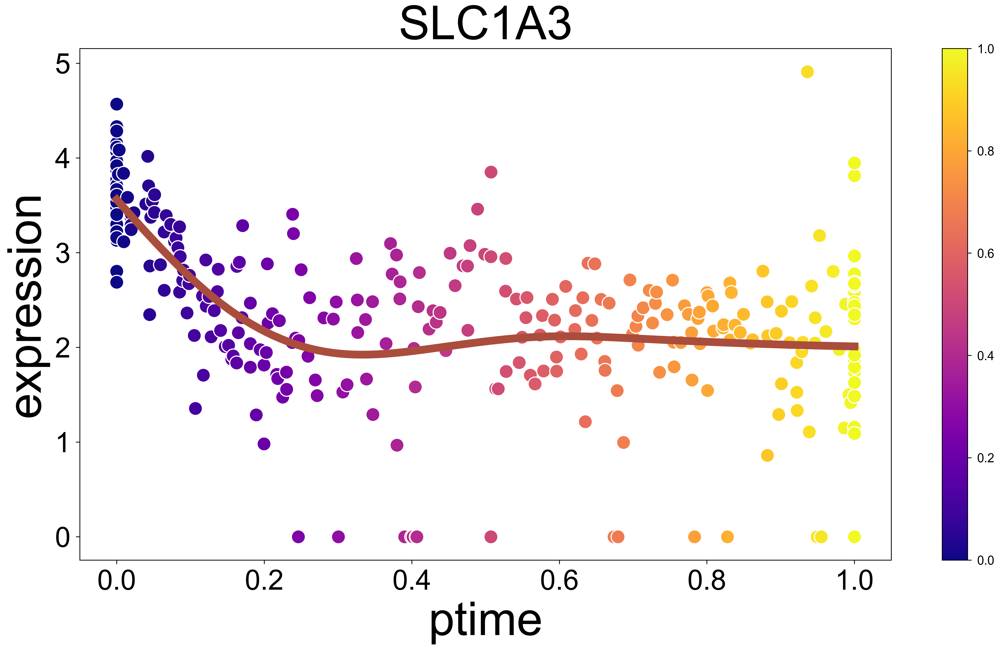

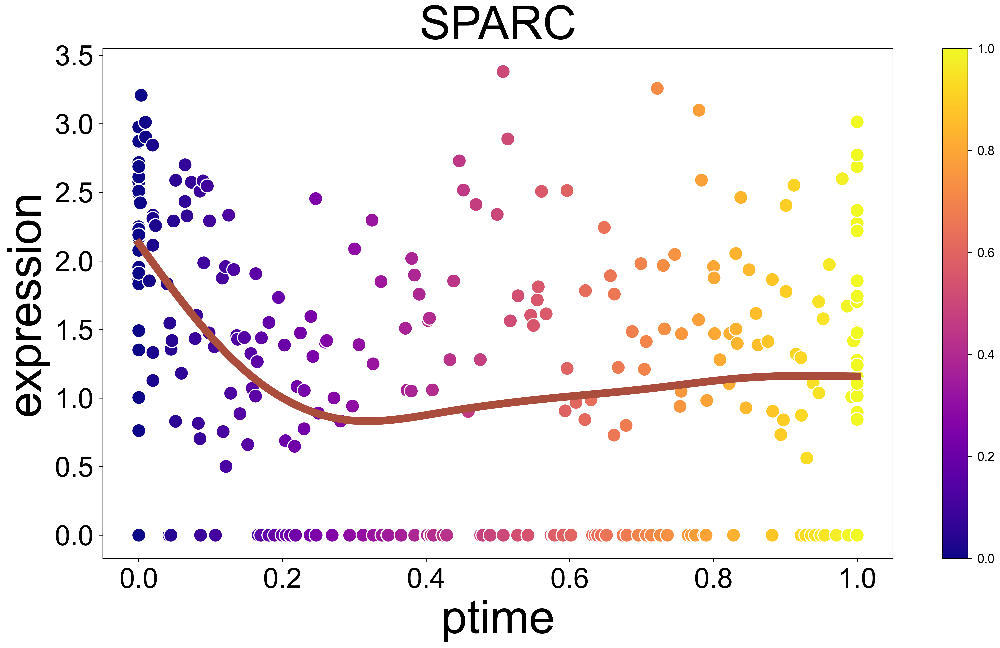

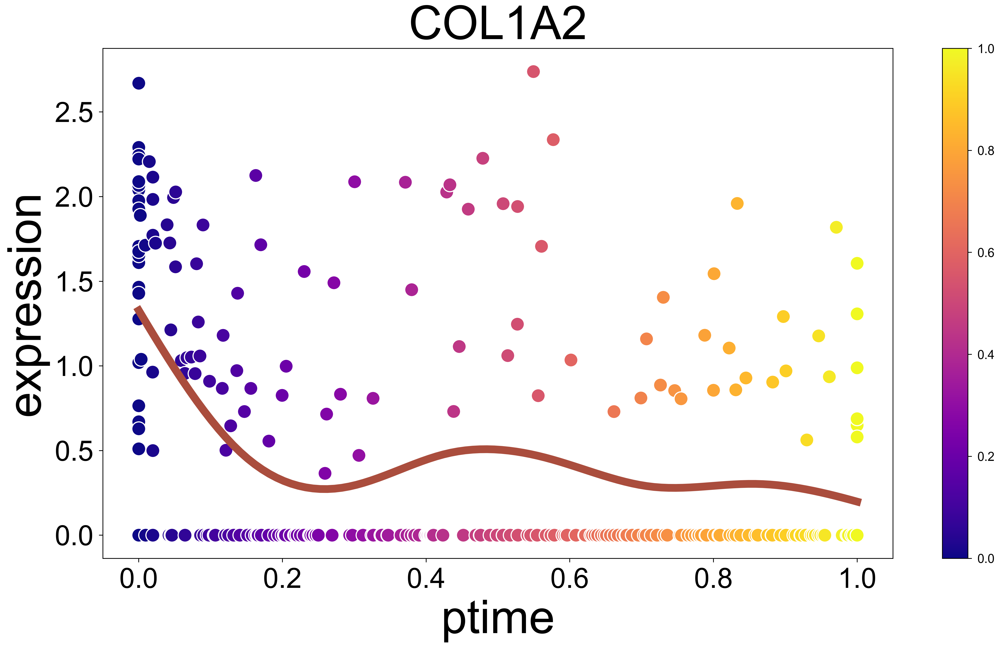

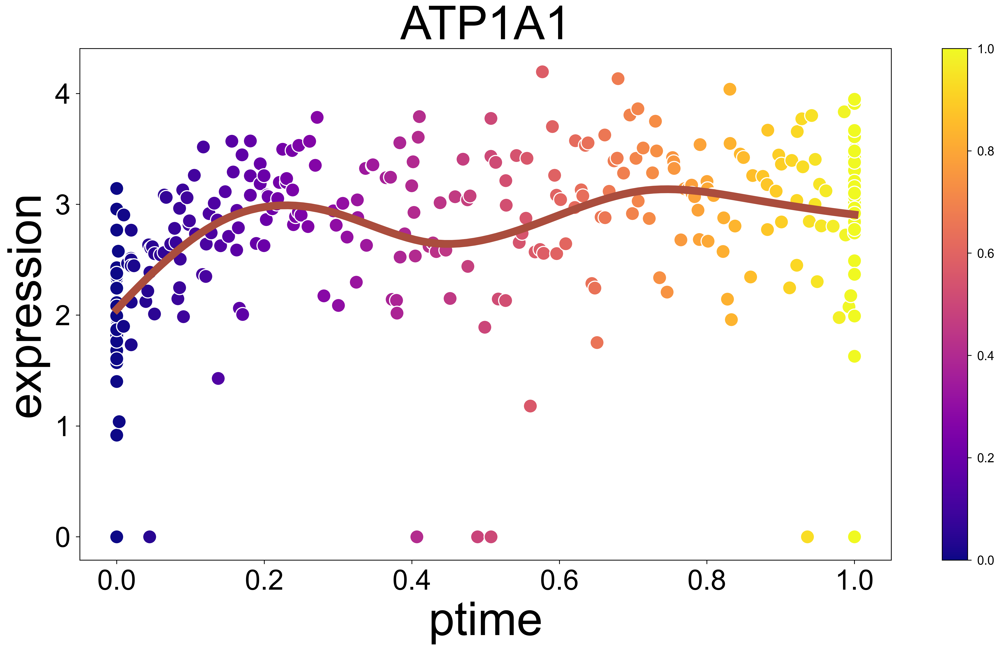

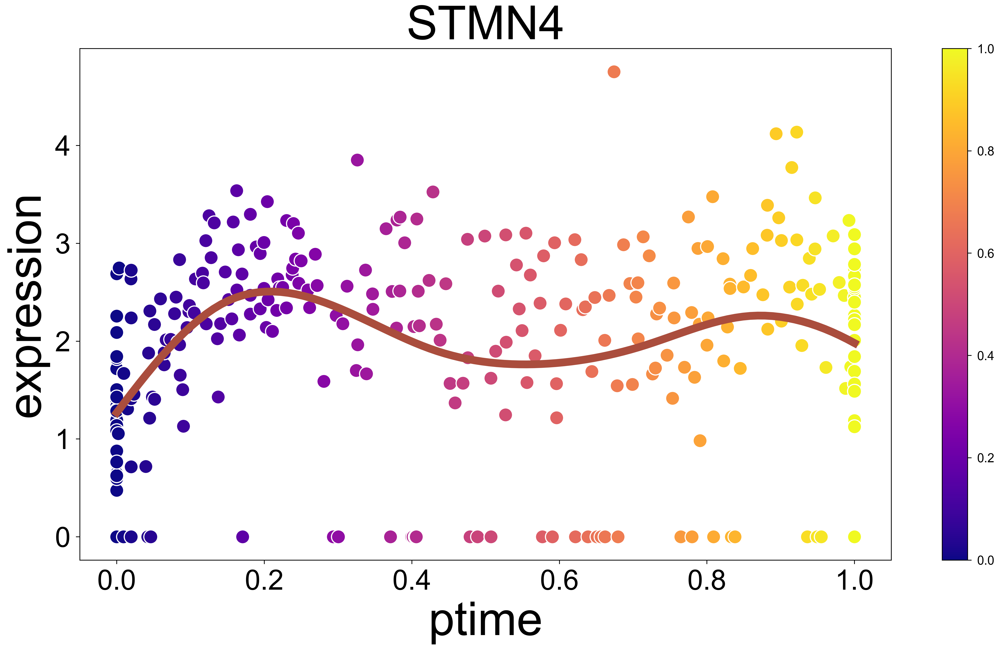

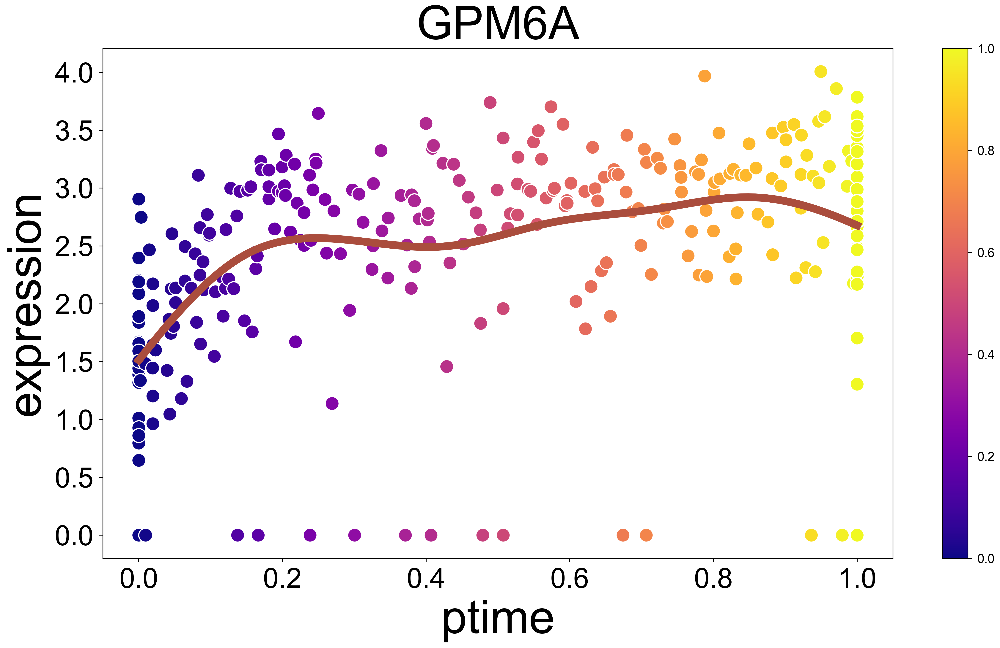

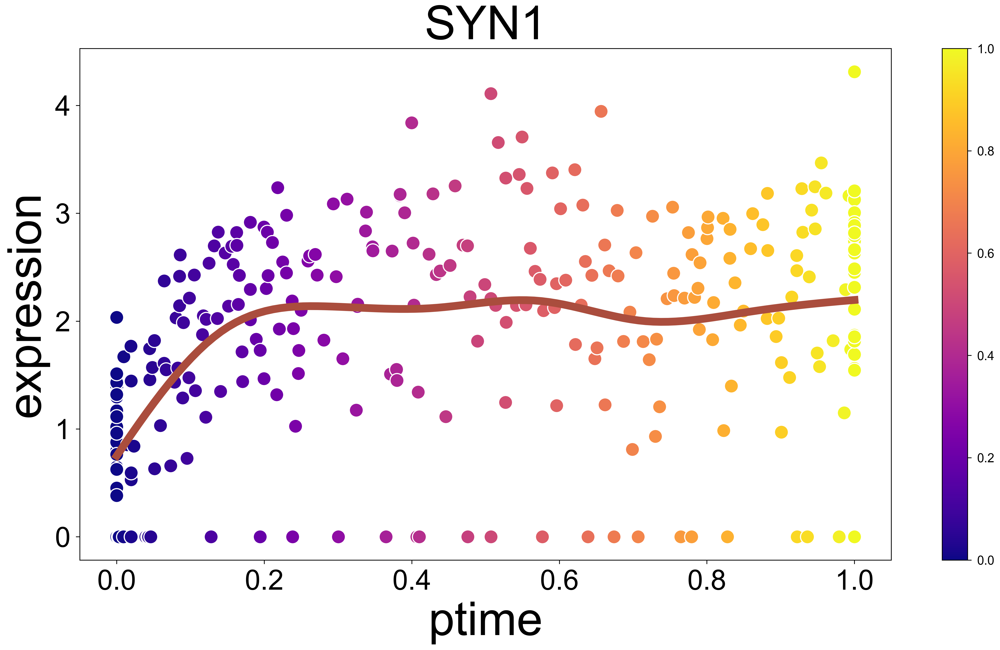

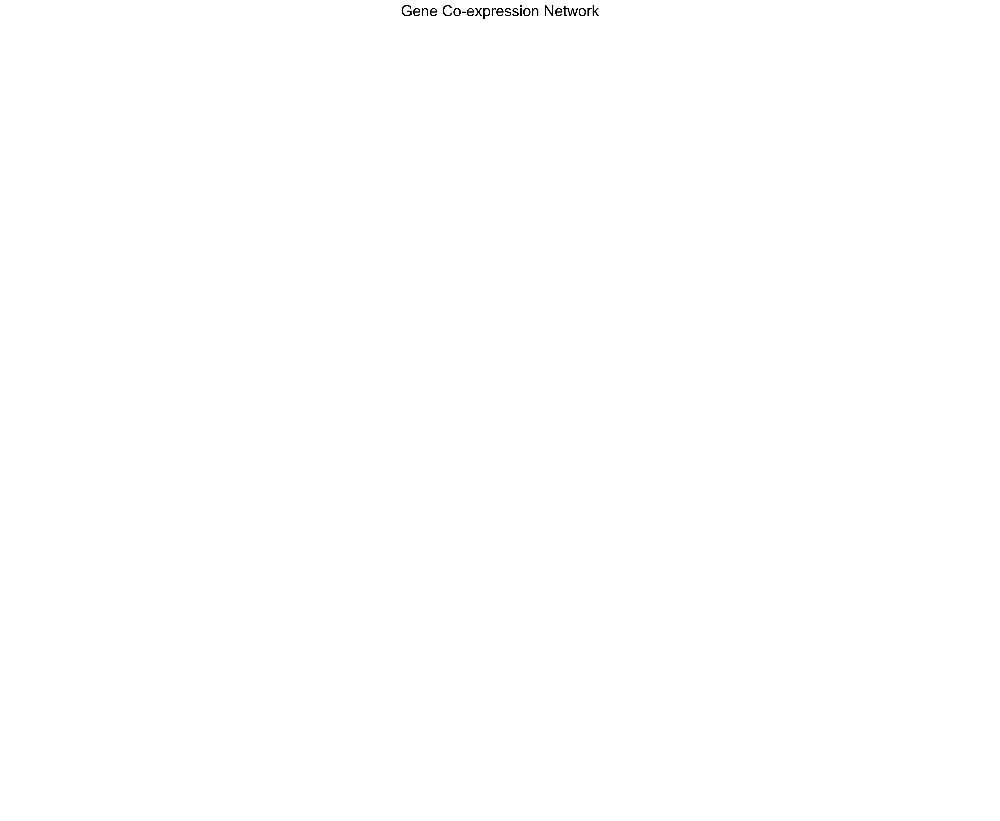

In [ ]:

key_genes = ['GFAP', 'SLC1A3', 'SPARC', 'COL1A2', 'ATP1A1', 'STMN4', 'GPM6A','SYN1']
for gene in key_genes:
    if gene in adata.var_names:
        spt.plot_trajectory_gene(sub_adata, gene_name=gene, point_size=80)
    else:
        print(f"{gene} not found in dataset")
import networkx as nx
from sklearn.metrics import pairwise_distances


gene_expr = adata[:, key_genes].X.toarray()
corr_matrix = 1 - pairwise_distances(gene_expr.T, metric='correlation')


G = nx.Graph()
for i, gene1 in enumerate(key_genes):
    for j, gene2 in enumerate(key_genes):
        if i < j and abs(corr_matrix[i,j]) > 0.6: 
            G.add_edge(gene1, gene2, weight=corr_matrix[i,j])

plt.figure(figsize=(10,8))
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_size=2000, 
        node_color='skyblue', font_size=12, font_weight='bold',
        edge_color=[G[u][v]['weight'] for u,v in G.edges()],
        width=4, edge_cmap=plt.cm.Blues)
plt.title('Gene Co-expression Network')
plt.show()

sc.tl.rank_genes_groups(adata, 'cluster', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

import gseapy as gp

marker_genes = {}
for cluster in adata.obs['cluster'].unique():
    markers = sc.get.rank_genes_groups_df(adata, group=cluster)
    marker_genes[cluster] = markers.names.tolist()[:50]



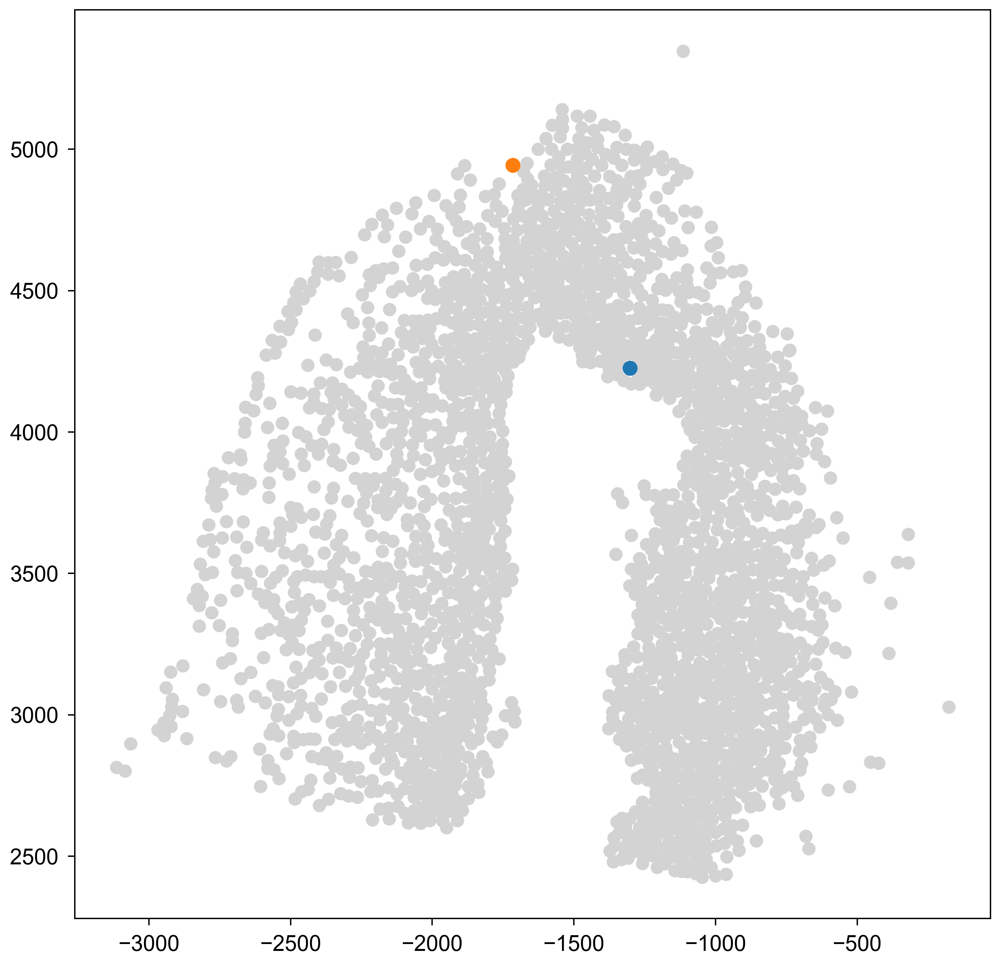

In [52]:
fig, ax = plt.subplots(figsize=(6, 6))

LAP_start_point=[-1300,4250]
LAP_end_point=[-1700,5000]
LAP_start_cell=spt.nearest_neighbors(LAP_start_point,adata.obsm['spatial'])[0][0]
LAP_end_cell=spt.nearest_neighbors(LAP_end_point,adata.obsm['spatial'])[0][0]

plt.scatter(*adata.obsm["spatial"].T,c='#D3D3D3',s=15)
plt.scatter(*adata[LAP_start_cell].obsm['spatial'].T,s=20)
plt.scatter(*adata[LAP_end_cell].obsm['spatial'].T,s=20)

In [53]:
import scipy.sparse as sp
adata.obsp["fused_trans"] = sp.csr_matrix(trans)

In [54]:
lap = spt.least_action(
    adata,
    init_cells=[adata.obs_names[LAP_start_cell]],  # 注意这里是 obs 名称，不是索引
    target_cells=[adata.obs_names[LAP_end_cell]],
    vecfld=VecFld,
    basis="spatial",
    adj_key="fused_trans",     # ✅ 使用你构造的融合转移矩阵
    EM_steps=5,
    n_points=20
)

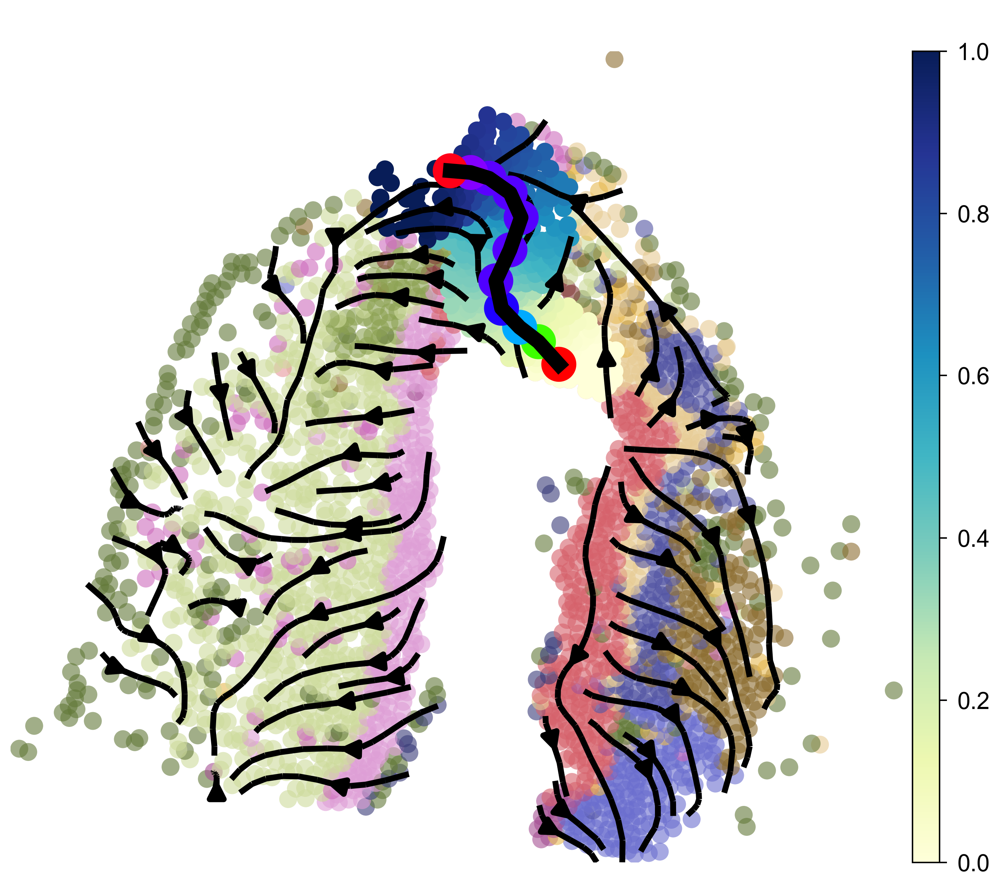

In [55]:
LAP_ptime,LAP_nbrs=spt.map_cell_to_LAP(adata,cell_neighbors=80)
sub_adata=adata[LAP_nbrs,:]
sub_adata.obs['ptime']=LAP_ptime
sub_adata=sub_adata[np.argsort(sub_adata.obs["ptime"].values), :].copy()

fig, ax = plt.subplots(figsize=(6,5))
plt.axis('off')
ax = sc.pl.embedding(adata,  basis='X_spatial',color='cluster',show=False,ax=ax,frameon=False,legend_loc=None,alpha=0.6,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.2,color='black',linewidth=2,arrowsize=1.2)
ax = spt.plot_least_action_path(adata,basis='spatial',ax=ax,point_size=120,linewidth=5)
sc.pl.embedding(sub_adata, basis='X_spatial',ax=ax, color="ptime", cmap="YlGnBu",frameon=True,size=150,title=' ')

In [56]:
sub_adata_path=sub_adata[sub_adata.obs['cluster'].isin(['reaEGC','rIPC2', 'IMN','dpEX'])]
sub_adata_path=spt.filter_gene(sub_adata_path,min_exp_prop=0.1,hvg_gene=3000)

clusters ordered by ptime:  ['reaEGC', 'rIPC2', 'dpEX', 'IMN']
Cell number	219
Gene number	383


In [57]:
df_res  = spt.ptime_gene_GAM(sub_adata_path,core_number=5)

Genes number fitted by GAM model:   383


In [58]:
df_sig_res = df_res.loc[(df_res['model_fit']>0.2) & (df_res['fdr']<0.05)]

Finally selected 54 genes.


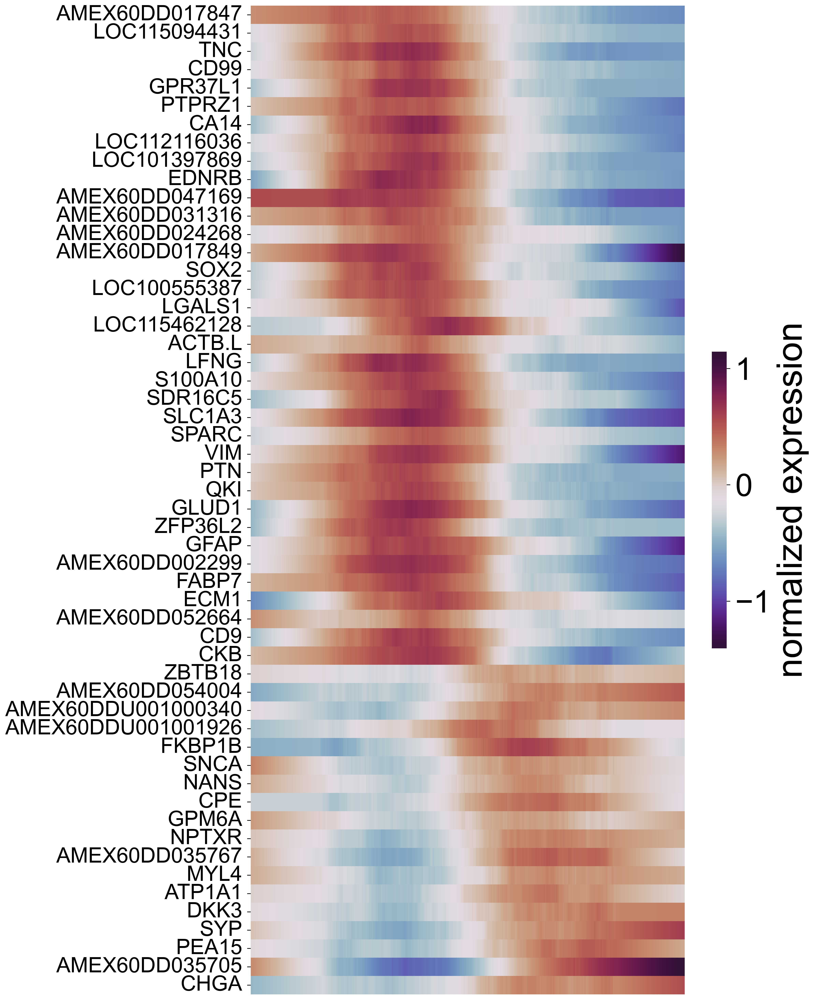

In [59]:
sort_exp_sig = spt.order_trajectory_genes(sub_adata,df_sig_res,cell_number=20)
spt.plot_trajectory_gene_heatmap(sort_exp_sig,smooth_length=100,gene_label_size=15,cmap_name='twilight_shifted')

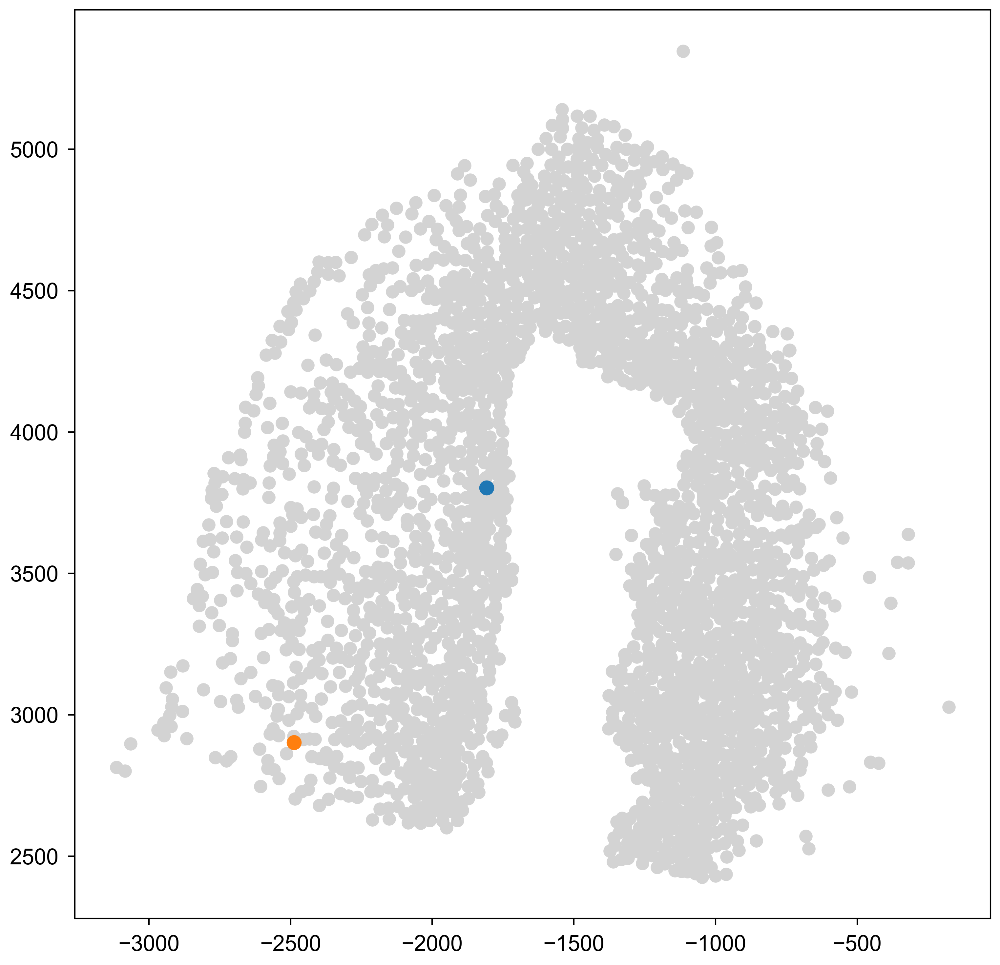

In [61]:
fig, ax = plt.subplots(figsize=(6, 6))

LAP_start_point=[-1800,3800]
LAP_end_point=[-2500,2900]
LAP_start_cell=spt.nearest_neighbors(LAP_start_point,adata.obsm['spatial'])[0][0]
LAP_end_cell=spt.nearest_neighbors(LAP_end_point,adata.obsm['spatial'])[0][0]

plt.scatter(*adata.obsm["spatial"].T,c='#D3D3D3',s=15)
plt.scatter(*adata[LAP_start_cell].obsm['spatial'].T,s=20)
plt.scatter(*adata[LAP_end_cell].obsm['spatial'].T,s=20)

In [62]:
import scipy.sparse as sp
adata.obsp["fused_trans"] = sp.csr_matrix(trans)

In [ ]:
lap = spt.least_action(
    adata,
    init_cells=[adata.obs_names[LAP_start_cell]], 
    target_cells=[adata.obs_names[LAP_end_cell]],
    vecfld=VecFld,
    basis="spatial",
    adj_key="fused_trans",    
    EM_steps=5,
    n_points=20
)

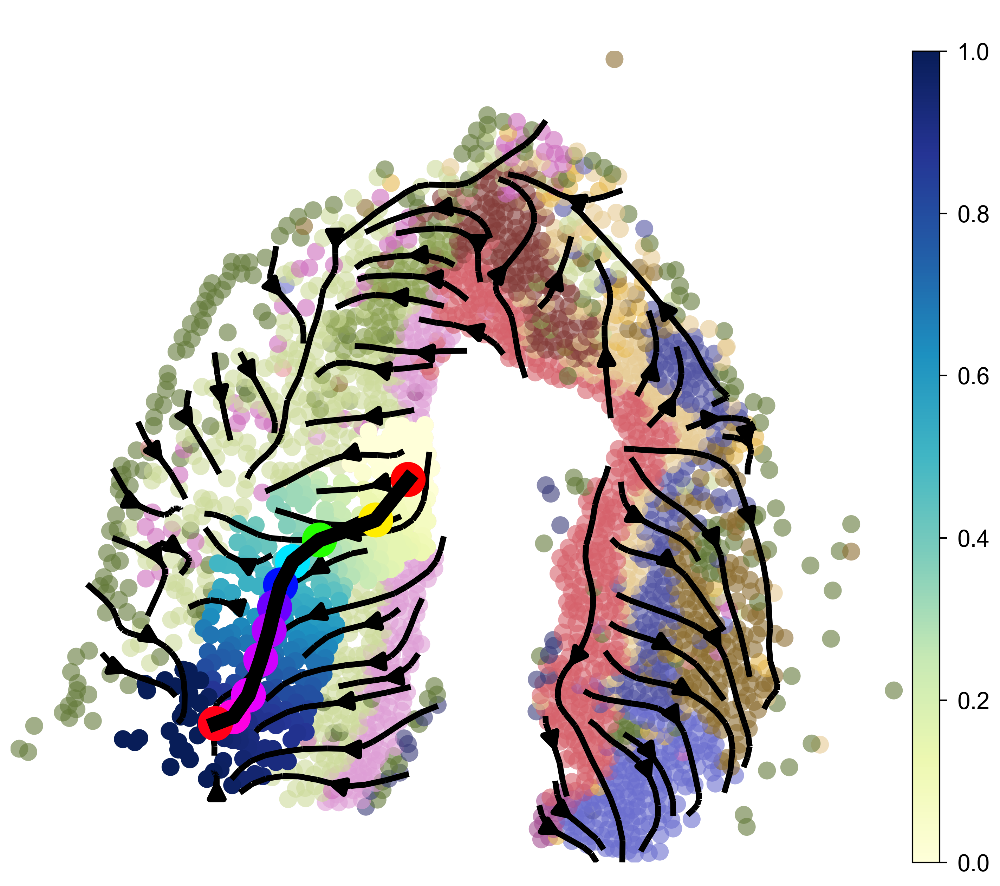

In [64]:
LAP_ptime,LAP_nbrs=spt.map_cell_to_LAP(adata,cell_neighbors=80)
sub_adata=adata[LAP_nbrs,:]
sub_adata.obs['ptime']=LAP_ptime
sub_adata=sub_adata[np.argsort(sub_adata.obs["ptime"].values), :].copy()

fig, ax = plt.subplots(figsize=(6,5))
plt.axis('off')
ax = sc.pl.embedding(adata,  basis='X_spatial',color='cluster',show=False,ax=ax,frameon=False,legend_loc=None,alpha=0.6,size=150)
ax.streamplot(adata.uns['E_grid'][0], adata.uns['E_grid'][1], adata.uns['V_grid'][0], adata.uns['V_grid'][1],density=1.2,color='black',linewidth=2,arrowsize=1.2)
ax = spt.plot_least_action_path(adata,basis='spatial',ax=ax,point_size=120,linewidth=5)
sc.pl.embedding(sub_adata, basis='X_spatial',ax=ax, color="ptime", cmap="YlGnBu",frameon=True,size=150,title=' ')

In [65]:
sub_adata_path=sub_adata[sub_adata.obs['cluster'].isin(['wntEGC','mpEX'])]
sub_adata_path=spt.filter_gene(sub_adata_path,min_exp_prop=0.1,hvg_gene=3000)

clusters ordered by ptime:  ['wntEGC', 'mpEX']
Cell number	292
Gene number	341


In [66]:
df_res  = spt.ptime_gene_GAM(sub_adata_path,core_number=5)

Genes number fitted by GAM model:   341


In [67]:
df_sig_res = df_res.loc[(df_res['model_fit']>0.2) & (df_res['fdr']<0.05)]

Finally selected 37 genes.


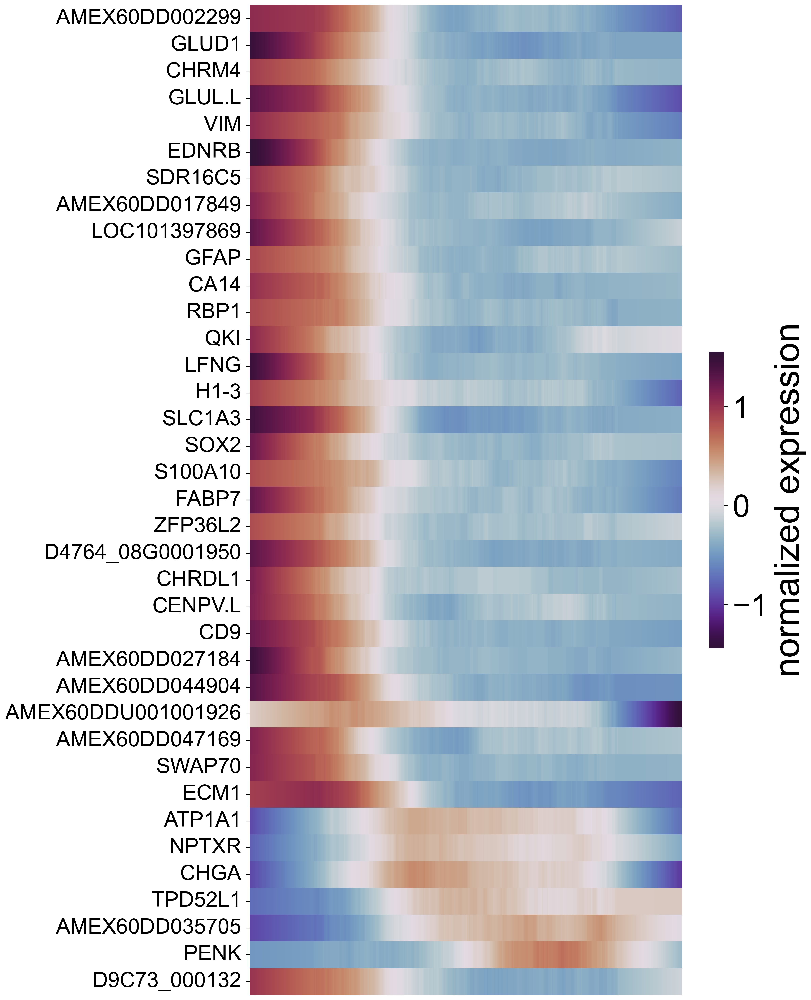

In [68]:
sort_exp_sig = spt.order_trajectory_genes(sub_adata,df_sig_res,cell_number=20)
spt.plot_trajectory_gene_heatmap(sort_exp_sig,smooth_length=100,gene_label_size=15,cmap_name='twilight_shifted')